The goal here is to train ONE RBM, then I will use similar code to do hyperparametric search.

In [1]:
# Activate project
using Pkg
Pkg.activate("/Users/alessiogiorlandino/Desktop/SAM/Project.toml")
Base.active_project()
# Resolve dependencies
Pkg.resolve()

  Activating project at `~/Desktop/SAM`


  No Changes to `~/Desktop/SAM/Project.toml`
  No Changes to `~/Desktop/SAM/Manifest.toml`


In [2]:
import Rfam, Infernal, Logomaker, FASTX
using Optimisers: Adam
using EllipsisNotation: (..)
using FillArrays: Falses
import Makie, CairoMakie
using Makie: @colorant_str
import SamApp
using LinearAlgebra
using Statistics
using LaTeXStrings
using DelimitedFiles: readdlm

In [3]:
using BioSequences: LongRNA, @rna_str
using Statistics: mean, std, cor
import JLD2

using Plots
import RestrictedBoltzmannMachines as RBMs
import CudaRBMs, CenteredRBMs
using CudaRBMs: gpu, cpu
using CenteredRBMs: CenteredRBM, center, uncenter, center_from_data!
using RestrictedBoltzmannMachines: initialize!, RBM, xReLU, Potts, pcd!, Binary, log_pseudolikelihood, free_energy
using RBMsAnnealedImportanceSampling: aise, raise, logmeanexp, logstdexp, logvarexp

import RestrictedBoltzmannMachines
using MiniLoggers: global_logger, MiniLogger
global_logger(MiniLogger());

# Load sequence data from Rfam

In [4]:
cm = Infernal.cmfetch(Rfam.cm(), "RF00162")
natural_seed_stk = Infernal.esl_afetch(Rfam.seed(), "RF00162");
natural_seed_afa = Infernal.esl_reformat("afa", natural_seed_stk.out);
natural_seed_ids = FASTX.identifier.(FASTX.FASTA.Reader(open(natural_seed_afa.out)));

# Consensus secondary structure in WUSS format
seed_wuss = SamApp.stockholm_ss(natural_seed_stk.out)
seed_match_positions = findall(c -> c ≠ '.' && c ≠ '~', seed_wuss);

natural_hits_afa = Infernal.cmalign(Infernal.cmfetch(Rfam.cm(), "RF00162").out, Rfam.fasta_file("RF00162"); outformat="afa");
natural_hits_ids = FASTX.identifier.(FASTX.FASTA.Reader(open(natural_hits_afa.out)));

In [5]:
natural_seed_sequences_matchonly = map(FASTX.FASTA.Reader(open(natural_seed_afa.out))) do record
    FASTX.sequence(record)[seed_match_positions]
end

natural_hits_sequences_matchonly = map(FASTX.FASTA.Reader(open(natural_hits_afa.out))) do record
    filter(c -> !islowercase(c) && c ≠ '.', FASTX.sequence(record))
end

@assert only(unique(length.(natural_seed_sequences_matchonly))) == length(seed_match_positions) == 108
@assert only(unique(length.(natural_hits_sequences_matchonly))) == length(seed_match_positions) == 108

In [6]:
data_hits = SamApp.onehot(LongRNA{4}.(natural_hits_sequences_matchonly));
label_file = open("labels.txt","r")
label =readdlm("labels.txt")


6112×1 Matrix{Any}:
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 ⋮
 "other"
 "Bacteroidota"
 "Bacillota"
 "Bacteroidota"
 "Bacillota"
 "Bacteroidota"
 "Actinomycetota"
 "other"
 "other"

In [7]:
SamApp.seqlogo_entropic(reshape(mean(data_hits; dims=3), 5, 108)).fig

PythonCall.PyException: Python: UnicodeEncodeError: 'ascii' codec can't encode character '\u229f' in position 21: ordinal not in range(128)

# PCA

In [8]:
function PCA(data)
    data_shape = size(data)
    cov_matrix = cov(data, dims=2)
    cov_eigenval = eigvals(cov_matrix)
    expl_ratio = cov_eigenval/sum(cov_eigenval)
    ort_trasf = eigvecs(cov_matrix)
    return transpose(ort_trasf)*data, expl_ratio,  ort_trasf
end
    


PCA (generic function with 1 method)

In [9]:
data_shape = size(data_hits)
data_flatten = reshape(data_hits, (data_shape[1]*data_shape[2], data_shape[3]))

data_flatten_rot, expl_ratio, _ = PCA(data_flatten)


([0.474904001412625 0.4749040014126248 … 0.4749040014126278 0.47490400141263467; -0.31295950608130696 -0.3129595060813052 … -0.3129595060813021 -0.3129595060812951; … ; -0.002506256511098176 0.6624870089304071 … -0.23221503180757558 -1.5631329559374116; 4.1319333247054795 3.772432339699068 … 1.621676915562134 1.799416255177813], [-8.970479039948518e-18, -7.362424520834739e-18, -6.735700208217175e-18, -5.978263083096702e-18, -5.4738926432970576e-18, -5.015299434785437e-18, -4.784325133202614e-18, -4.625979005137508e-18, -4.3651150855584474e-18, -4.2426615574146734e-18  …  0.016413208835863433, 0.017429863202782468, 0.0212129701406351, 0.023391155420478784, 0.025243487653912815, 0.027956916862654006, 0.02993200365680448, 0.04387393386481623, 0.045843645289221066, 0.0721349168048522], [-0.005006075500965821 -0.0037353910306901273 … -0.024501985406433724 -0.027969274226703873; -0.005006075500965865 -0.003735391030689034 … 0.003868015550437953 0.03724768711020731; … ; -0.13785277425551506 -

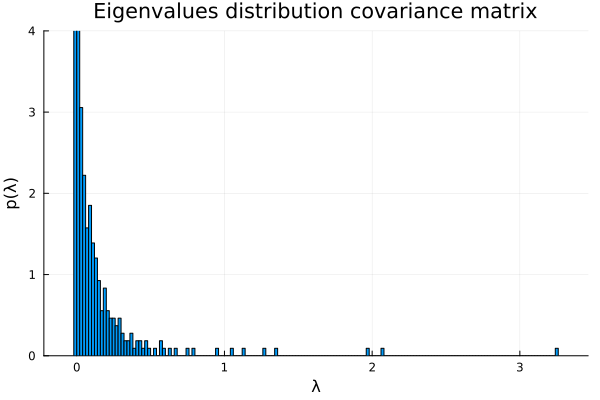

In [10]:
cov_eigenval = eigvals(cov(data_flatten, dims=2))
histogram(cov_eigenval, normalize=:pdf, ylim=(0,4), legend=false, title="Eigenvalues distribution covariance matrix")
xlabel!("λ")
ylabel!("p(λ)")

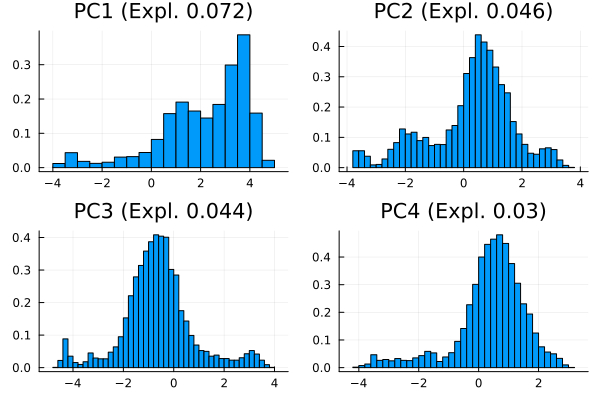

In [11]:
# First Component Histogram 
pc1 = data_flatten_rot[end, :]
p1=histogram(pc1, normalize=:pdf, title=("PC1 (Expl. $(round(expl_ratio[end], digits=3)))"))


pc2 = data_flatten_rot[end-1, :]
p2=histogram(pc2, normalize=:pdf, title=("PC2 (Expl. $(round(expl_ratio[end-1], digits=3)))"))

pc3 = data_flatten_rot[end-2, :]
p3=histogram(pc3, normalize=:pdf, title=("PC3 (Expl. $(round(expl_ratio[end-2], digits=3)))"))

pc4 = data_flatten_rot[end-3, :]
p4=histogram(pc4, normalize=:pdf, title=("PC4 (Expl. $(round(expl_ratio[end-3], digits=3)))"))


plot(p1, p2, p3, p4, layout=(2,2), legend=false)

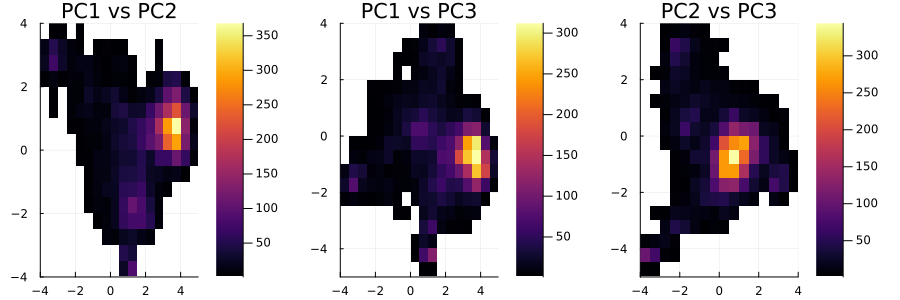

In [12]:
p1=histogram2d(pc1, pc2, title="PC1 vs PC2")
p2=histogram2d(pc1, pc3, title="PC1 vs PC3")
p3=histogram2d(pc2, pc3, title="PC2 vs PC3")

plot(p1, p2, p3, layout=(1,3), legend=false, size=(900,300))

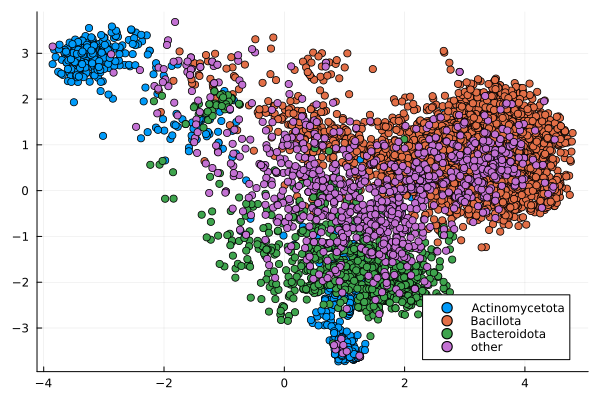

In [13]:
using DataFrames, StatsPlots
df_v = DataFrame(PC1=pc1, PC2=pc2, PC3=pc3, PC4=pc4, Label=label[:,]) 
# exclude "other" from plotting
#filter!(row -> row.Label .!= "other", df_v)

scatter(df_v.PC1 , df_v.PC2, group=df_v.Label)


# Train RBM

## RBM 1

In [14]:
# Sparsity parameter, as defined in Tubiana, RM, 2017 PRL (denoted \hat{p} there)
# This is smaller for sparser weights
function sparsity(rbm)
    num = sum(rbm.w.^2, dims=1:ndims(rbm.visible)).^2
    den = sum(rbm.w.^4, dims=1:ndims(rbm.visible))
    return sum(num ./ den) / length(rbm.w)
end

sparsity (generic function with 1 method)

In [15]:
function callback(; rbm, iter, kw...)
    if iszero(iter % 100)
        Δt = @elapsed (lpl = mean(log_pseudolikelihood(rbm, data)))
        if iszero(iter % 1000)
            @info iter lpl Δt
        end
        write(logfile, "$iter $lpl \n")
    end

end

callback (generic function with 1 method)

[2023-04-26 14:38:07] Info: 1000 lpl = -0.4452250651738793, Δt = 0.293955917


[2023-04-26 14:38:53] Info: 2000 lpl = -0.3727186200096786, Δt = 0.233105417


[2023-04-26 14:39:39] Info: 3000 lpl = -0.34896963494642014, Δt = 0.242752042


[2023-04-26 14:40:30] Info: 4000 lpl = -0.35098504245077394, Δt = 0.242087458


[2023-04-26 14:41:16] Info: 5000 lpl = -0.32539297314493343, Δt = 0.243159292


[2023-04-26 14:42:00] Info: 6000 lpl = -0.3125136133171015, Δt = 0.249121958


[2023-04-26 14:42:44] Info: 7000 lpl = -0.2956287813096608, Δt = 0.255080458


[2023-04-26 14:43:29] Info: 8000 lpl = -0.293950574815059, Δt = 0.256607791


[2023-04-26 14:44:14] Info: 9000 lpl = -0.26612018286787287, Δt = 0.25361975


[2023-04-26 14:44:59] Info: 10000 lpl = -0.2765658500924224, Δt = 0.255386584


[2023-04-26 14:45:42] Info: 11000 lpl = -0.2605131970954167, Δt = 0.258782667


[2023-04-26 14:46:26] Info: 12000 lpl = -0.2649435190611724, Δt = 0.266579


[2023-04-26 14:47:11] Info: 13000 lpl = -0.26309444801352505, Δt = 0.272976875


[2023-04-26 14:47:58] Info: 14000 lpl = -0.2562099294370982, Δt = 0.2903785


[2023-04-26 14:48:45] Info: 15000 lpl = -0.24424337570473575, Δt = 0.268069125


[2023-04-26 14:49:32] Info: 16000 lpl = -0.25889548773489923, Δt = 0.267263584


[2023-04-26 14:50:19] Info: 17000 lpl = -0.2396227286172407, Δt = 0.273491667


[2023-04-26 14:51:05] Info: 18000 lpl = -0.24759592888552603, Δt = 0.262788625


[2023-04-26 14:51:49] Info: 19000 lpl = -0.23823051341048704, Δt = 0.26518825


[2023-04-26 14:52:35] Info: 20000 lpl = -0.24409576985712236, Δt = 0.263341833


[2023-04-26 14:54:38] Info: 21000 lpl = -0.23747691429227857, Δt = 0.270412458


[2023-04-26 15:00:24] Info: 22000 lpl = -0.2284135085271351, Δt = 0.266306583


[2023-04-26 15:01:07] Info: 23000 lpl = -0.23789459943731892, Δt = 0.263327875


[2023-04-26 15:05:24] Info: 24000 lpl = -0.23477229930939264, Δt = 0.280219958


[2023-04-26 15:06:09] Info: 25000 lpl = -0.24666342065977942, Δt = 0.267113292


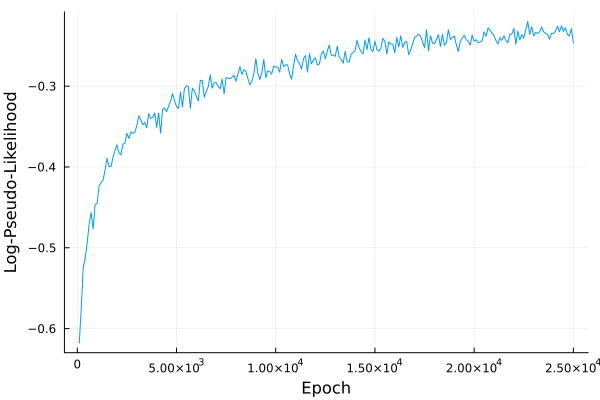

In [16]:
logfile = open("./Log/Stacked1.txt", "w+")


data = data_hits;
n_hidden1 = 256
rbm1 = center(RBM(Potts((5, 108)), Binary((n_hidden1,)), zeros(5, 108, n_hidden1)));
initialize!(rbm1, data);
pcd!(
    rbm1, data; 
    batchsize=256, iters=25000, steps=10, optim=Adam(1f-3), l2l1_weights=1f-3,
    vm=data[.., rand(1:size(data)[end], 256)], callback
);

close(logfile)

logdata = readdlm("./Log/Stacked1.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood")

## RBM 2


[2023-04-26 15:06:24] Info: 1000 lpl = -0.4663460915025628, Δt = 0.036452833


[2023-04-26 15:06:38] Info: 2000 lpl = -0.42779473827791625, Δt = 0.042331208


[2023-04-26 15:06:51] Info: 3000 lpl = -0.4208107862175181, Δt = 0.038748208


[2023-04-26 15:07:05] Info: 4000 lpl = -0.4137690364831281, Δt = 0.038960625


[2023-04-26 15:07:18] Info: 5000 lpl = -0.41507274016023415, Δt = 0.049857375


[2023-04-26 15:07:31] Info: 6000 lpl = -0.4119510279855778, Δt = 0.038472584


[2023-04-26 15:07:45] Info: 7000 lpl = -0.38872169619431846, Δt = 0.039526125


[2023-04-26 15:08:00] Info: 8000 lpl = -0.38295679294860413, Δt = 0.04544975


[2023-04-26 15:08:15] Info: 9000 lpl = -0.39919718815511396, Δt = 0.03968325


[2023-04-26 15:08:29] Info: 10000 lpl = -0.3727420951441876, Δt = 0.040582875


[2023-04-26 15:08:43] Info: 11000 lpl = -0.3833630878184329, Δt = 0.04045325


[2023-04-26 15:08:56] Info: 12000 lpl = -0.3837661422932879, Δt = 0.040901625


[2023-04-26 15:09:10] Info: 13000 lpl = -0.3868928371746879, Δt = 0.041024916


[2023-04-26 15:09:24] Info: 14000 lpl = -0.3788706434563162, Δt = 0.040919167


[2023-04-26 15:09:37] Info: 15000 lpl = -0.36639507968697055, Δt = 0.041799542


[2023-04-26 15:09:51] Info: 16000 lpl = -0.37878762574658775, Δt = 0.039855875


[2023-04-26 15:10:05] Info: 17000 lpl = -0.3757906386403983, Δt = 0.041560542


[2023-04-26 15:10:20] Info: 18000 lpl = -0.37358962730840306, Δt = 0.041475291


[2023-04-26 15:10:35] Info: 19000 lpl = -0.36456438353019505, Δt = 0.041873334


[2023-04-26 15:10:49] Info: 20000 lpl = -0.38385766790456927, Δt = 0.040352083


[2023-04-26 15:11:04] Info: 21000 lpl = -0.37483842964841185, Δt = 0.04188975


[2023-04-26 15:11:19] Info: 22000 lpl = -0.36975144814774263, Δt = 0.040306167


[2023-04-26 15:11:34] Info: 23000 lpl = -0.3718793450116515, Δt = 0.043218375


[2023-04-26 15:11:48] Info: 24000 lpl = -0.37440334798251795, Δt = 0.041819958


[2023-04-26 15:12:02] Info: 25000 lpl = -0.36950300001173236, Δt = 0.041143542


[2023-04-26 15:12:18] Info: 26000 lpl = -0.3675089068113338, Δt = 0.040955333


[2023-04-26 15:12:31] Info: 27000 lpl = -0.3708921447729235, Δt = 0.040970209


[2023-04-26 15:12:46] Info: 28000 lpl = -0.3716010853238602, Δt = 0.040283417


[2023-04-26 15:13:01] Info: 29000 lpl = -0.36524172420027395, Δt = 0.039682208


[2023-04-26 15:13:15] Info: 30000 lpl = -0.37054225791446066, Δt = 0.041414


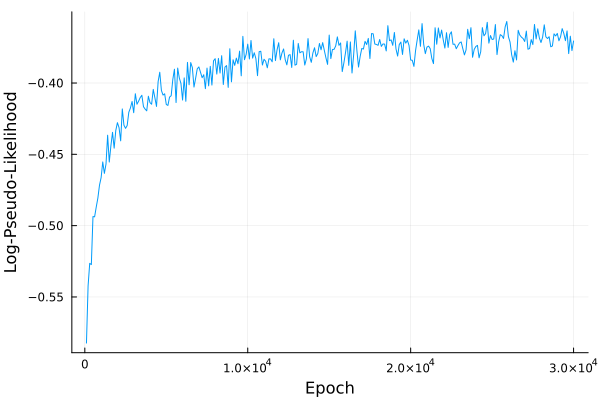

In [17]:
#Build data 
hidden_data1 = zeros(n_hidden1, data_shape[3])
for i in 1:data_shape[3]
    hidden_data1[:,i]=RestrictedBoltzmannMachines.sample_h_from_v(rbm1, data_hits[:,:,i]) 
end

logfile = open("./Log/Stacked2.txt", "w+")


n_hidden2 = 128
data = hidden_data1

rbm2 = center(RBM(Binary((n_hidden1,)), Binary((n_hidden2,)), zeros(n_hidden1, n_hidden2)));
initialize!(rbm2, data);

pcd!(
    rbm2, data; 
    batchsize=256, iters=30000, steps=10, optim=Adam(1f-3), l2l1_weights=1f-3,
    vm=hidden_data1[.., rand(1:size(hidden_data1)[end], 256)], callback
);

close(logfile)

logdata = readdlm("./Log/Stacked2.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood") 

## RBM 3


[2023-04-26 15:13:22] Info: 1000 lpl = -0.481546325178423, Δt = 0.016639625


[2023-04-26 15:13:29] Info: 2000 lpl = -0.44259966526843314, Δt = 0.017802708


[2023-04-26 15:13:36] Info: 3000 lpl = -0.4306532881288836, Δt = 0.018696708


[2023-04-26 15:13:44] Info: 4000 lpl = -0.43166500618601966, Δt = 0.020318458


[2023-04-26 15:13:51] Info: 5000 lpl = -0.41458014756948075, Δt = 0.018531625


[2023-04-26 15:13:57] Info: 6000 lpl = -0.4193142122158939, Δt = 0.018087458


[2023-04-26 15:14:04] Info: 7000 lpl = -0.4030054566115545, Δt = 0.018856375


[2023-04-26 15:14:11] Info: 8000 lpl = -0.41026446400032013, Δt = 0.019163042


[2023-04-26 15:14:17] Info: 9000 lpl = -0.422123197217522, Δt = 0.018998459


[2023-04-26 15:14:24] Info: 10000 lpl = -0.40757256588569485, Δt = 0.0188985


[2023-04-26 15:14:31] Info: 11000 lpl = -0.40459358711210397, Δt = 0.019134417


[2023-04-26 15:14:39] Info: 12000 lpl = -0.40654416164954893, Δt = 0.01919575


[2023-04-26 15:14:46] Info: 13000 lpl = -0.40630685201708605, Δt = 0.019288916


[2023-04-26 15:14:53] Info: 14000 lpl = -0.3984586563663749, Δt = 0.019189833


[2023-04-26 15:15:00] Info: 15000 lpl = -0.4098498111855102, Δt = 0.019066583


[2023-04-26 15:15:08] Info: 16000 lpl = -0.40518306145901606, Δt = 0.019044458


[2023-04-26 15:15:15] Info: 17000 lpl = -0.39467013339517754, Δt = 0.019486583


[2023-04-26 15:15:22] Info: 18000 lpl = -0.3994364731840316, Δt = 0.019180333


[2023-04-26 15:15:28] Info: 19000 lpl = -0.40227046520105103, Δt = 0.019196041


[2023-04-26 15:15:35] Info: 20000 lpl = -0.3901927064215486, Δt = 0.018982834


[2023-04-26 15:15:41] Info: 21000 lpl = -0.4043268840862638, Δt = 0.019057958


[2023-04-26 15:15:50] Info: 22000 lpl = -0.4003335230042798, Δt = 0.022042334


[2023-04-26 15:15:57] Info: 23000 lpl = -0.4154624607372595, Δt = 0.018383625


[2023-04-26 15:16:04] Info: 24000 lpl = -0.3944886373453434, Δt = 0.018672


[2023-04-26 15:16:11] Info: 25000 lpl = -0.39402137555482325, Δt = 0.018964209


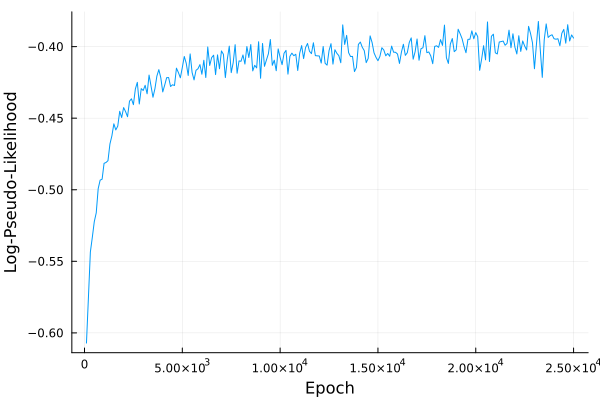

In [18]:
#Build data 
hidden_data2 = zeros(n_hidden2, data_shape[3])
for i in 1:data_shape[3]
    hidden_data2[:,i] = RestrictedBoltzmannMachines.sample_h_from_v(rbm2, hidden_data1[:,i]) 
end

logfile = open("./Log/Stacked3.txt", "w+")


n_hidden3 = 64
data=hidden_data2

rbm3 = center(RBM(Binary((n_hidden2,)), Binary((n_hidden3,)), zeros(n_hidden2, n_hidden3)));
initialize!(rbm3, data);

pcd!(
    rbm3, data; 
    batchsize=256, iters=25000, steps=10, optim=Adam(1f-3), l2l1_weights=1f-3,
    vm=hidden_data2[.., rand(1:size(hidden_data2)[end], 256)], callback
);

close(logfile)

logdata = readdlm("./Log/Stacked3.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood")

## RBM 4

[2023-04-26 15:16:15] Info: 1000 lpl = -0.48690831689079217, Δt = 0.007826458


[2023-04-26 15:16:19] Info: 2000 lpl = -0.453711577231737, Δt = 0.008142833


[2023-04-26 15:16:23] Info: 3000 lpl = -0.4347127394041217, Δt = 0.00951225


[2023-04-26 15:16:27] Info: 4000 lpl = -0.41007015472022046, Δt = 0.008349916


[2023-04-26 15:16:31] Info: 5000 lpl = -0.4057093188187253, Δt = 0.008532083


[2023-04-26 15:16:34] Info: 6000 lpl = -0.40738606056955856, Δt = 0.008366083


[2023-04-26 15:16:37] Info: 7000 lpl = -0.40213763206178277, Δt = 0.008375166


[2023-04-26 15:16:41] Info: 8000 lpl = -0.4033493882018142, Δt = 0.009158958


[2023-04-26 15:16:45] Info: 9000 lpl = -0.3838652878854134, Δt = 0.00949775


[2023-04-26 15:16:49] Info: 10000 lpl = -0.3981961064288564, Δt = 0.0085045


[2023-04-26 15:16:52] Info: 11000 lpl = -0.3891548571263183, Δt = 0.008508208


[2023-04-26 15:16:55] Info: 12000 lpl = -0.3812533928983052, Δt = 0.008901208


[2023-04-26 15:16:59] Info: 13000 lpl = -0.3919727520287611, Δt = 0.00897825


[2023-04-26 15:17:02] Info: 14000 lpl = -0.3833011746898563, Δt = 0.009074542


[2023-04-26 15:17:05] Info: 15000 lpl = -0.38456554306734214, Δt = 0.009008333


[2023-04-26 15:17:09] Info: 16000 lpl = -0.3925147602384007, Δt = 0.009029459


[2023-04-26 15:17:12] Info: 17000 lpl = -0.3811589637019072, Δt = 0.009199792


[2023-04-26 15:17:17] Info: 18000 lpl = -0.3762181168085054, Δt = 0.010032458


[2023-04-26 15:17:21] Info: 19000 lpl = -0.39793322139865644, Δt = 0.009039125


[2023-04-26 15:17:24] Info: 20000 lpl = -0.375557652620113, Δt = 0.00856


[2023-04-26 15:17:28] Info: 21000 lpl = -0.390703457026381, Δt = 0.0090145


[2023-04-26 15:17:31] Info: 22000 lpl = -0.3663128823964837, Δt = 0.00854125


[2023-04-26 15:17:35] Info: 23000 lpl = -0.3788294205678492, Δt = 0.008526084


[2023-04-26 15:17:38] Info: 24000 lpl = -0.3782845701597722, Δt = 0.00901775


[2023-04-26 15:17:41] Info: 25000 lpl = -0.3786328754438233, Δt = 0.009059709


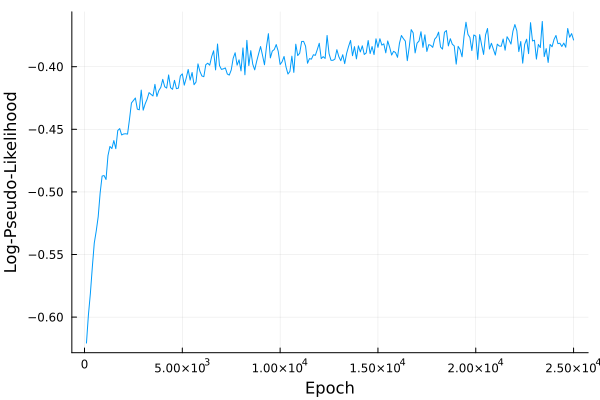

In [19]:
#Build data 
hidden_data3 = zeros(n_hidden3, data_shape[3])
for i in 1:data_shape[3]
    hidden_data3[:,i] = RestrictedBoltzmannMachines.sample_h_from_v(rbm3, hidden_data2[:,i]) 
end

logfile = open("./Log/Stacked4.txt", "w+")


n_hidden4 = 32
data = hidden_data3

rbm4 = center(RBM(Binary((n_hidden3,)), Binary((n_hidden4,)), zeros(n_hidden3, n_hidden4)));
initialize!(rbm4, data);

pcd!(
    rbm4, data; 
    batchsize=256, iters=25000, steps=10, optim=Adam(1f-3), l2l1_weights=1f-3,
    vm=hidden_data3[.., rand(1:size(hidden_data2)[end], 256)], callback
);

close(logfile)

logdata = readdlm("./Log/Stacked4.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood")

# RBM 5


[2023-04-26 15:17:44] Info: 1000 lpl = -0.5253761603774285, Δt = 0.003485959


[2023-04-26 15:17:46] Info: 2000 lpl = -0.47163568997257377, Δt = 0.0048845


[2023-04-26 15:17:48] Info: 3000 lpl = -0.44641779747848537, Δt = 0.004132791


[2023-04-26 15:17:49] Info: 4000 lpl = -0.4209354671883614, Δt = 0.003977875


[2023-04-26 15:17:51] Info: 5000 lpl = -0.3993479901904932, Δt = 0.004339916


[2023-04-26 15:17:53] Info: 6000 lpl = -0.40605070929576637, Δt = 0.004276625


[2023-04-26 15:17:54] Info: 7000 lpl = -0.3810541464515001, Δt = 0.004256417


[2023-04-26 15:17:56] Info: 8000 lpl = -0.4071601415295025, Δt = 0.004336458


[2023-04-26 15:17:57] Info: 9000 lpl = -0.39514076067740245, Δt = 0.0042495


[2023-04-26 15:17:59] Info: 10000 lpl = -0.38052563386832083, Δt = 0.004067708


[2023-04-26 15:18:01] Info: 11000 lpl = -0.3861402995919452, Δt = 0.004247125


[2023-04-26 15:18:03] Info: 12000 lpl = -0.3889751350459754, Δt = 0.004249917


[2023-04-26 15:18:04] Info: 13000 lpl = -0.4003222169898338, Δt = 0.004052125


[2023-04-26 15:18:06] Info: 14000 lpl = -0.3918897918515341, Δt = 0.004158875


[2023-04-26 15:18:08] Info: 15000 lpl = -0.3918634697458941, Δt = 0.004269916


[2023-04-26 15:18:09] Info: 16000 lpl = -0.3878616466784619, Δt = 0.004252167


[2023-04-26 15:18:11] Info: 17000 lpl = -0.39456958011848364, Δt = 0.004211417


[2023-04-26 15:18:13] Info: 18000 lpl = -0.38167631493169984, Δt = 0.004038291


[2023-04-26 15:18:15] Info: 19000 lpl = -0.38054819408167345, Δt = 0.004202459


[2023-04-26 15:18:16] Info: 20000 lpl = -0.3839790871859689, Δt = 0.004261125


[2023-04-26 15:18:18] Info: 21000 lpl = -0.3747922815750253, Δt = 0.00431


[2023-04-26 15:18:20] Info: 22000 lpl = -0.36671392736044706, Δt = 0.004035958


[2023-04-26 15:18:21] Info: 23000 lpl = -0.3890323930531871, Δt = 0.004233209


[2023-04-26 15:18:23] Info: 24000 lpl = -0.39186867593541375, Δt = 0.004223709


[2023-04-26 15:18:25] Info: 25000 lpl = -0.38023818329330383, Δt = 0.004204625


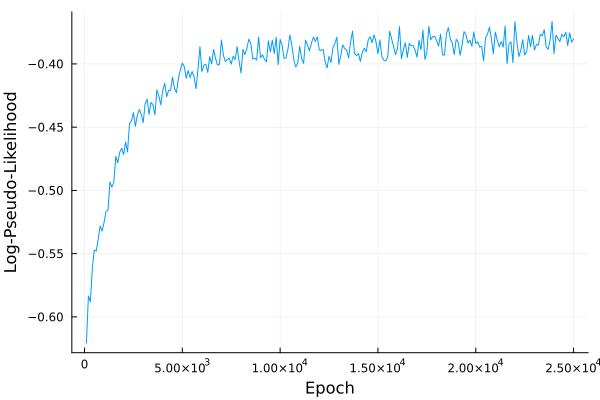

In [20]:
#Build data 
hidden_data4 = zeros(n_hidden4, data_shape[3])
for i in 1:data_shape[3]
    hidden_data4[:,i] = RestrictedBoltzmannMachines.sample_h_from_v(rbm4, hidden_data3[:,i]) 
end

logfile = open("./Log/Stacked5.txt", "w+")


n_hidden5 = 16
data = hidden_data4

rbm5 = center(RBM(Binary((n_hidden4,)), Binary((n_hidden5,)), zeros(n_hidden4, n_hidden5)));
initialize!(rbm5, data);

pcd!(
    rbm5, data; 
    batchsize=256, iters=25000, steps=10, optim=Adam(1f-3), l2l1_weights=1f-3,
    vm=hidden_data4[.., rand(1:size(hidden_data2)[end], 256)], callback
);

close(logfile)

logdata = readdlm("./Log/Stacked5.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood")

[2023-04-26 15:18:26] Info: 1000 lpl = -0.5394294511015283, Δt = 0.001124375


[2023-04-26 15:18:27] Info: 2000 lpl = -0.5316167784832551, Δt = 0.001158583


[2023-04-26 15:18:28] Info: 3000 lpl = -0.5272829968936036, Δt = 0.001120292


[2023-04-26 15:18:29] Info: 4000 lpl = -0.4897408899500711, Δt = 0.001142958


[2023-04-26 15:18:29] Info: 5000 lpl = -0.47833712946656326, Δt = 0.0027145


[2023-04-26 15:18:31] Info: 6000 lpl = -0.4592092781224686, Δt = 0.006473625


[2023-04-26 15:18:32] Info: 7000 lpl = -0.44562424803743006, Δt = 0.001306833


[2023-04-26 15:18:32] Info: 8000 lpl = -0.4435047576140195, Δt = 0.001202833


[2023-04-26 15:18:33] Info: 9000 lpl = -0.4252172392519878, Δt = 0.001273458


[2023-04-26 15:18:34] Info: 10000 lpl = -0.41809199233872674, Δt = 0.0014685


[2023-04-26 15:18:35] Info: 11000 lpl = -0.42826176990860876, Δt = 0.001312083


[2023-04-26 15:18:36] Info: 12000 lpl = -0.4208164590396104, Δt = 0.001393959


[2023-04-26 15:18:37] Info: 13000 lpl = -0.42382547289352335, Δt = 0.001206708


[2023-04-26 15:18:37] Info: 14000 lpl = -0.4228311604159204, Δt = 0.001319625


[2023-04-26 15:18:38] Info: 15000 lpl = -0.4232866553888705, Δt = 0.00124925


[2023-04-26 15:18:39] Info: 16000 lpl = -0.41169074975524583, Δt = 0.001315417


[2023-04-26 15:18:40] Info: 17000 lpl = -0.4334568338918517, Δt = 0.001316709


[2023-04-26 15:18:41] Info: 18000 lpl = -0.4209445101189873, Δt = 0.0012185


[2023-04-26 15:18:42] Info: 19000 lpl = -0.4032649882897662, Δt = 0.00125875


[2023-04-26 15:18:42] Info: 20000 lpl = -0.4161497786063063, Δt = 0.001228125


[2023-04-26 15:18:43] Info: 21000 lpl = -0.39795252028402456, Δt = 0.001197875


[2023-04-26 15:18:44] Info: 22000 lpl = -0.40781990848578065, Δt = 0.00128


[2023-04-26 15:18:45] Info: 23000 lpl = -0.41197271008259817, Δt = 0.001234375


[2023-04-26 15:18:46] Info: 24000 lpl = -0.4046651589458028, Δt = 0.001229042


[2023-04-26 15:18:46] Info: 25000 lpl = -0.4027698320109894, Δt = 0.001229042


[2023-04-26 15:18:47] Info: 26000 lpl = -0.4026113110130734, Δt = 0.001342791


[2023-04-26 15:18:48] Info: 27000 lpl = -0.39588597685525295, Δt = 0.00124075


[2023-04-26 15:18:49] Info: 28000 lpl = -0.4067310838721326, Δt = 0.001217958


[2023-04-26 15:18:50] Info: 29000 lpl = -0.4098476798703997, Δt = 0.001221833


[2023-04-26 15:18:51] Info: 30000 lpl = -0.4006574659067335, Δt = 0.001304584


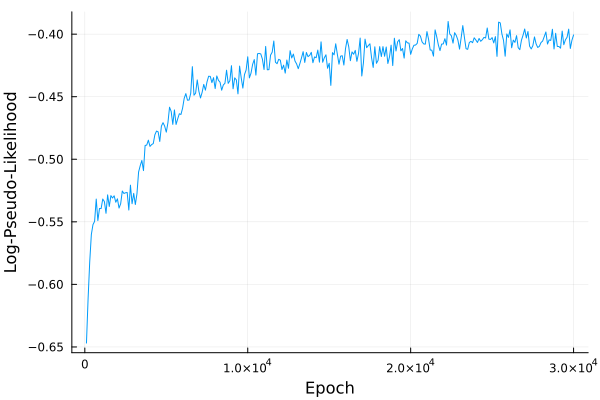

In [21]:
#Build data 
hidden_data5 = zeros(n_hidden5, data_shape[3])
for i in 1:data_shape[3]
    hidden_data5[:,i] = RestrictedBoltzmannMachines.sample_h_from_v(rbm5, hidden_data4[:,i]) 
end

logfile = open("./Log/Stacked6.txt", "w+")


n_hidden6 = 4
data = hidden_data5

rbm6 = center(RBM(Binary((n_hidden5,)), Binary((n_hidden6,)), zeros(n_hidden5, n_hidden6)));
initialize!(rbm6, data);

pcd!(
    rbm6, data; 
    batchsize=256, iters=30000, steps=10, optim=Adam(1f-3), l2l1_weights=1f-3,
    vm=hidden_data5[.., rand(1:size(hidden_data2)[end], 256)], callback
);

close(logfile)

logdata = readdlm("./Log/Stacked6.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood")

In [22]:
#Build data 
hidden_data6 = zeros(n_hidden6, data_shape[3])
for i in 1:data_shape[3]
    hidden_data6[:,i] = RestrictedBoltzmannMachines.sample_h_from_v(rbm6, hidden_data5[:,i]) 
end


In [23]:
#Saving Params
wfile = open("./Log/weights_stacked1.txt", "w+")
write(wfile, "$rbm1.w)")
close(wfile)

wfile = open("./Log/weights_stacked2.txt", "w+")
write(wfile, "$rbm2.w)")
close(wfile)

wfile = open("./Log/weights_stacked3.txt", "w+")
write(wfile, "$rbm3.w)")
close(wfile)

wfile = open("./Log/weights_stacked4.txt", "w+")
write(wfile, "$rbm4.w)")
close(wfile)

wfile = open("./Log/weights_stacked5.txt", "w+")
write(wfile, "$rbm5.w)")
close(wfile)

wfile = open("./Log/weights_stacked6.txt", "w+")
write(wfile, "$rbm6.w)")
close(wfile)


# Deeper and Deeper PCA representation

In [24]:
v_data_rot, expl_ratio_v, O_v = PCA(reshape(data_hits, (data_shape[1]*data_shape[2], data_shape[3])))
h1_data_rot, expl_ratio_h1, O_1 = PCA(hidden_data1)
h2_data_rot, expl_ratio_h2, O_2 = PCA(hidden_data2)
h3_data_rot, expl_ratio_h3, O_3 = PCA(hidden_data3)
h4_data_rot, expl_ratio_h4, O_4 = PCA(hidden_data4)
h5_data_rot, expl_ratio_h5, O_5 = PCA(hidden_data5)
h6_data_rot, expl_ratio_h6, O_6 = PCA(hidden_data6)




pca_v = [v_data_rot[end-i, :] for i in 0:3]
pca_h1 = [h1_data_rot[end-i, :] for i in 0:3]
pca_h2 = [h2_data_rot[end-i, :] for i in 0:3]
pca_h3 = [h3_data_rot[end-i, :] for i in 0:3]
pca_h4 = [h4_data_rot[end-i, :] for i in 0:3]
pca_h5 = [h5_data_rot[end-i, :] for i in 0:3]
pca_h6 = [h6_data_rot[end-i, :] for i in 0:3]



using DataFrames, StatsPlots
df_h1 = DataFrame(PC1=pca_h1[1], PC2=pca_h1[2], PC3=pca_h1[3], PC4=pca_h1[4], Label=label[:,])
df_h2 = DataFrame(PC1=pca_h2[1], PC2=pca_h2[2], PC3=pca_h2[3], PC4=pca_h2[4], Label=label[:,]) 
df_h3 = DataFrame(PC1=pca_h3[1], PC2=pca_h3[2], PC3=pca_h3[3], PC4=pca_h3[4], Label=label[:,]) 
df_h4 = DataFrame(PC1=pca_h4[1], PC2=pca_h4[2], PC3=pca_h4[3], PC4=pca_h4[4], Label=label[:,]) 
df_h5 = DataFrame(PC1=pca_h5[1], PC2=pca_h5[2], PC3=pca_h5[3], PC4=pca_h5[4], Label=label[:,]) 
df_h6 = DataFrame(PC1=pca_h6[1], PC2=pca_h6[2], PC3=pca_h6[3], PC4=pca_h6[4], Label=label[:,]) 




# exclude "other" from plotting 
#=
filter!(row -> row.Label .!= "other", df_v)
filter!(row -> row.Label .!= "other", df_h1)
filter!(row -> row.Label .!= "other", df_h2)
filter!(row -> row.Label .!= "other", df_h3) =#


Row,PC1,PC2,PC3,PC4,Label
,Float64,Float64,Float64,Float64,Any
1,0.0,0.0,0.0,0.0,Bacillota
2,-0.425167,-0.811129,0.271363,0.296082,Bacillota
3,0.0,0.0,0.0,0.0,Bacillota
4,0.0,0.0,0.0,0.0,Bacillota
5,0.0,0.0,0.0,0.0,Bacillota
6,-0.425167,-0.811129,0.271363,0.296082,Bacillota
7,-0.425167,-0.811129,0.271363,0.296082,Bacillota
8,0.0,0.0,0.0,0.0,Bacillota
9,-0.425167,-0.811129,0.271363,0.296082,Bacillota


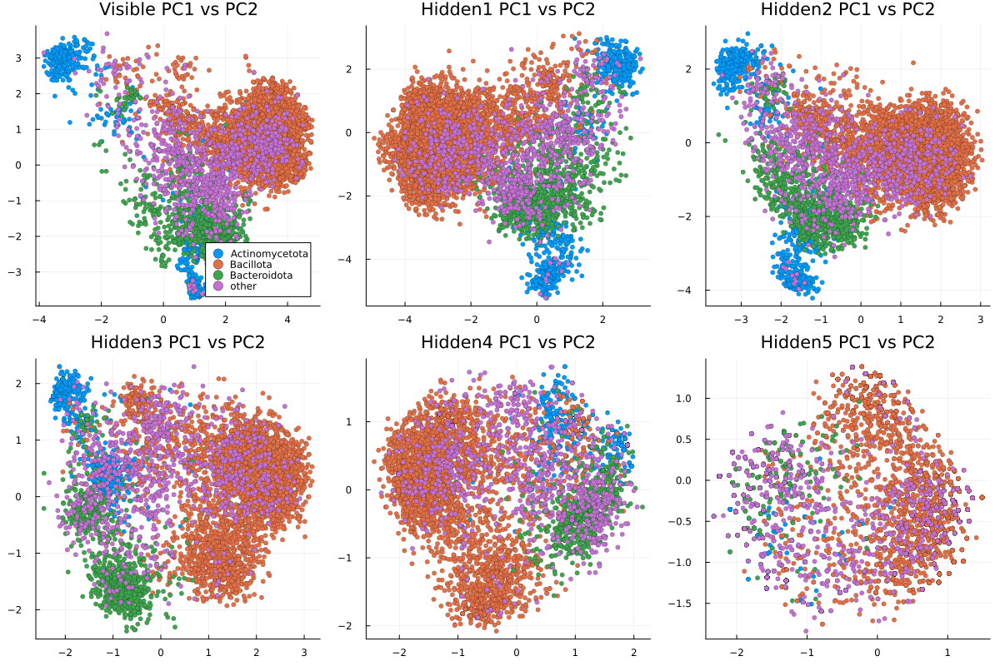

In [25]:
p1 = scatter(df_v.PC1 , df_v.PC2, markerstrokewidth=0.1, ms=3, group=df_v.Label, title="Visible PC1 vs PC2")
p2 = scatter(df_h1.PC1 , markerstrokewidth=0.1, ms=3, df_h1.PC2*(-1), group=df_h1.Label, title="Hidden1 PC1 vs PC2", legend=false)
p3 = scatter(df_h2.PC1 , markerstrokewidth=0.1, ms=3, df_h2.PC2, group=df_h2.Label, title="Hidden2 PC1 vs PC2", legend=false)
p4 = scatter(df_h3.PC1 , markerstrokewidth=0.1, ms=3, df_h3.PC2, group=df_h3.Label,title="Hidden3 PC1 vs PC2", legend=false)
p5 = scatter(df_h4.PC1 , markerstrokewidth=0.1, ms=3, df_h4.PC2, group=df_h4.Label, title="Hidden4 PC1 vs PC2", legend=false)
p6 = scatter(df_h5.PC1 , markerstrokewidth=0.1, ms=3, df_h5.PC2, group=df_h5.Label,title="Hidden5 PC1 vs PC2", legend=false)


plot(p1, p2, p3, p4, p5, p6, layout=(2,3), size=(1200,800))

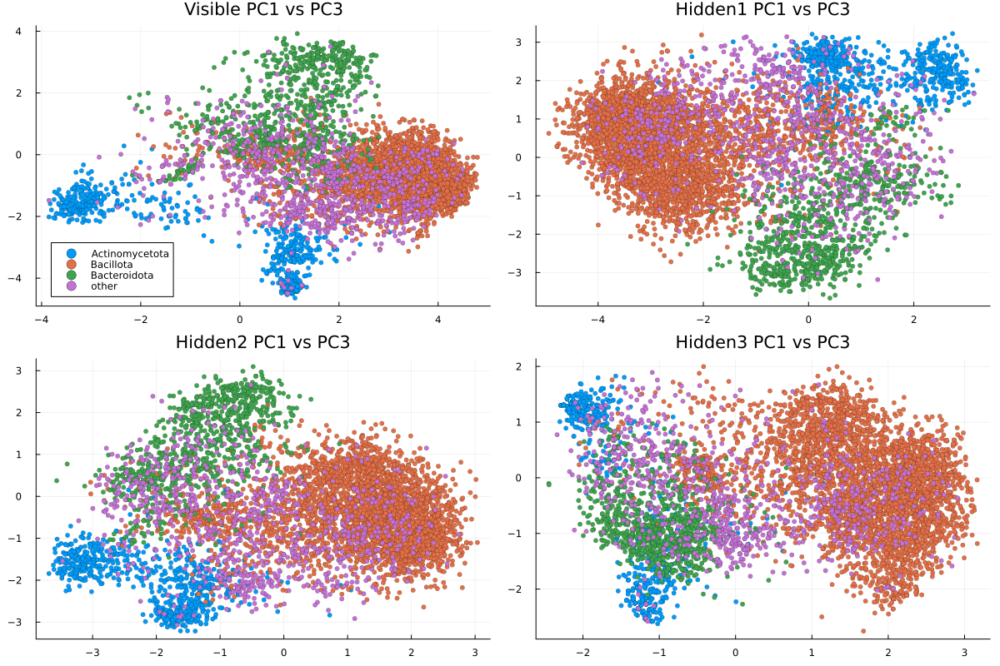

In [26]:
p1 = scatter(df_v.PC1 , markerstrokewidth=0.1, ms=3, df_v.PC3, group=df_v.Label, title="Visible PC1 vs PC3")
p2 = scatter(df_h1.PC1, markerstrokewidth=0.1, ms=3, df_h1.PC3, group=df_h1.Label, title="Hidden1 PC1 vs PC3", legend=false)
p3 = scatter(df_h2.PC1, markerstrokewidth=0.1, ms=3, df_h2.PC3, group=df_h2.Label, title="Hidden2 PC1 vs PC3", legend=false)
p4 = scatter(df_h3.PC1, markerstrokewidth=0.1, ms=3, df_h3.PC3, group=df_h3.Label,title="Hidden3 PC1 vs PC3", legend=false)


plot(p1, p2, p3, p4, layout=(2,2), size=(1200,800))

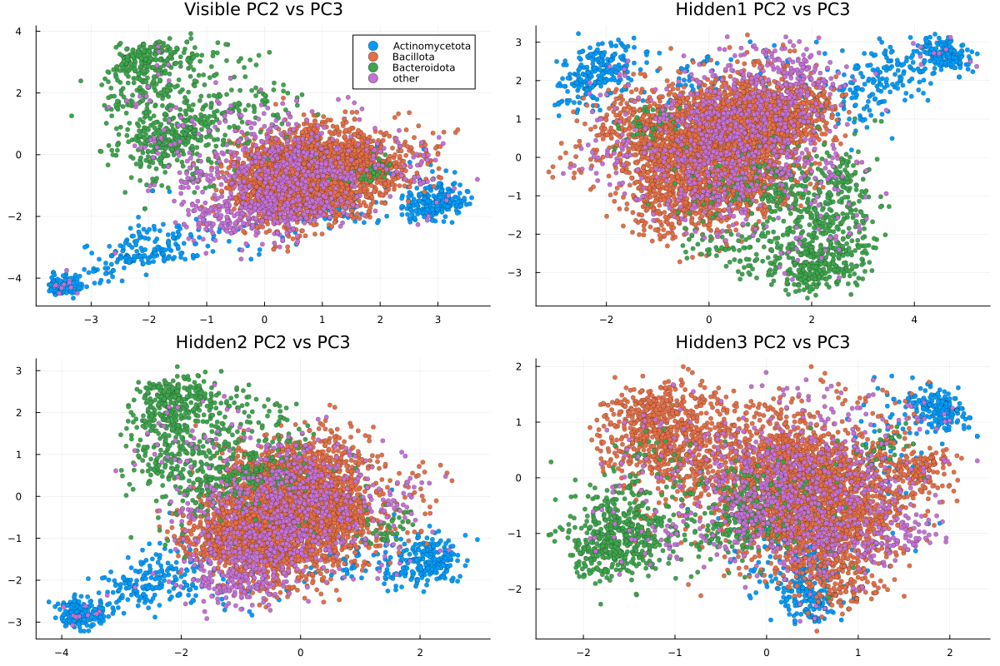

In [27]:
p1 = scatter(df_v.PC2, markerstrokewidth=0.1, ms=3, df_v.PC3, group=df_v.Label, title="Visible PC2 vs PC3")
p2 = scatter(df_h1.PC2, markerstrokewidth=0.1, ms=3 , df_h1.PC3, group=df_h1.Label, title="Hidden1 PC2 vs PC3", legend=false)
p3 = scatter(df_h2.PC2, markerstrokewidth=0.1, ms=3 , df_h2.PC3, group=df_h2.Label, title="Hidden2 PC2 vs PC3", legend=false)
p4 = scatter(df_h3.PC2, markerstrokewidth=0.1, ms=3 , df_h3.PC3, group=df_h3.Label,title="Hidden3 PC2 vs PC3", legend=false)


plot(p1, p2, p3, p4, layout=(2,2), size=(1200,800))

# Checking Replica Exchange Probability

In [28]:
#Binary Case
function E_v(v_conf, rbm)
    Γ_sum = 0
    for μ in 1:length(rbm.hidden)
        Γ_sum += log( 2*cosh( rbm.hidden.θ[μ] + (Transpose(rbm.w)*v_conf)[μ] ))
    end 
    return - (dot(rbm.visible.θ, v_conf) + Γ_sum)
end

function E_h(h_conf, rbm)
    Γ_sum = 0
    for i in 1:length(rbm.visible)  
        Γ_sum += log( 2*cosh( rbm.visible.θ[i] + (rbm.w*h_conf)[i] ))
    end 
    return - (dot(rbm.hidden.θ, h_conf) + Γ_sum)
end

E_h (generic function with 1 method)

In [36]:
using RestrictedBoltzmannMachines: sample_h_from_v, sample_v_from_h
function A(rbm_n, rbm_nplus1, N_MC=1000)
    conf_init = rand(0:1,length(rbm_nplus1.visible))
    E_vnplus1_given_vnplus1 = [E_v(conf_init, rbm_nplus1)]
    E_hn_given_vnplus1 = [E_h(conf_init, rbm_n)]
    E_vplusone_given_hn = [E_v(conf_init, rbm_nplus1)]
    E_hn_given_hn = [E_h(conf_init, rbm_n)]

    conf_v_nplus1 = conf_init
    conf_h_n = conf_init

    for step in 1:N_MC
        #dynamics on rbm3:
        conf_h_temp = sample_h_from_v(rbm_nplus1, conf_v_nplus1)
        conf_v_nplus1 = sample_v_from_h(rbm_nplus1, conf_h_temp)

        #dynamics on rbm2:
        conf_v_temp = sample_v_from_h(rbm_n, conf_h_n)
        conf_h_n = sample_h_from_v(rbm_n, conf_v_temp)
        

        #compute energies:
        push!(E_vnplus1_given_vnplus1, E_v(conf_v_nplus1, rbm_nplus1))
        push!(E_hn_given_vnplus1, E_h(conf_v_nplus1, rbm_n))
        push!(E_vplusone_given_hn, E_v(conf_h_n, rbm_nplus1))
        push!(E_hn_given_hn, E_h(conf_h_n, rbm_n))
    end  
    return (E_vplusone_given_hn .+ E_hn_given_vnplus1) ./ (E_vnplus1_given_vnplus1 .+ E_hn_given_hn)
end 

A (generic function with 2 methods)

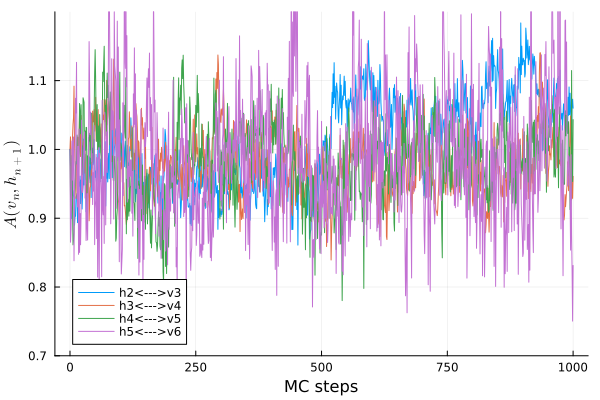

In [37]:
N_MC = 1000
plot(0:N_MC, A(rbm2, rbm3, N_MC), label="h2<--->v3")
plot!(0:N_MC, A(rbm3, rbm4, N_MC), label="h3<--->v4")
plot!(0:N_MC, A(rbm4, rbm5, N_MC), label="h4<--->v5")
plot!(0:N_MC, A(rbm5, rbm6, N_MC), label="h5<--->v6")
xlabel!("MC steps")
ylabel!(L"A(v_n, h_{n+1})")
ylims!((0.7, 1.2))

## Exchange $v_2 \longleftrightarrow h_1 $ (FINISH!)

In [31]:
#Pott's Case

#=
function E_h_potts(h_conf, rbm)
    Γ_sum = 0
    for i in 1:length(rbm.visible)  
        Γ_sum += log( 2*cosh( rbm.visible.θ[i] + (rbm.w*h_conf)[i] )) #part that changes 
    end 
    return - (dot(rbm.hidden.θ, h_conf) + Γ_sum)
end

=#

In [32]:
#=

conf_init = rand(0:1,length(rbm2.visible))


E_v2_on_v2 = [E_v(conf_init, rbm2)]
E_h1_on_v2 = [E_h(conf_init, rbm1)] #
E_v2_on_h1 = [E_v(conf_init, rbm2)]
E_h1_on_h1 = [E_h(conf_init, rbm1)] #


conf_v_2 = conf_init
conf_h_1 = conf_init

N_MC = 2000

for n in 1:N_MC
    #dynamics on rbm2:
    conf_h_temp = sample_h_from_v(rbm2, conf_v_2)
    conf_v_2 = sample_v_from_h(rbm2, conf_h_temp)

    #dynamics on rbm1:
    conf_v_temp = sample_v_from_h(rbm1, conf_h_1)
    conf_h_1 = sample_h_from_v(rbm1, conf_v_temp)
    

    #compute energies:
    push!(E_v2_on_v2, E_v(conf_v_2, rbm2))
    push!(E_h1_on_v2, E_h(conf_v_1, rbm2))
    push!(E_v2_on_h1, E_v(conf_h_1, rbm1))
    push!(E_h1_on_h1, E_h(conf_h_1, rbm1)) 
end 


plot(0:N_MC, E_v2_on_v2 .+ E_h1_on_h1, label= "E_v2(v2) + E_h1(h1)")
plot!(0:N_MC, E_v2_on_h1 .+ E_h1_on_v2, label= "E_v2(h1) + E_h1(v2)") =#


# Statistics of Number of final Hidden toggles

## Distribution of number of turned on toggles
That is, take the final representation of a sequence (4 binary units) and check how many, out of the 4, are turne on. 

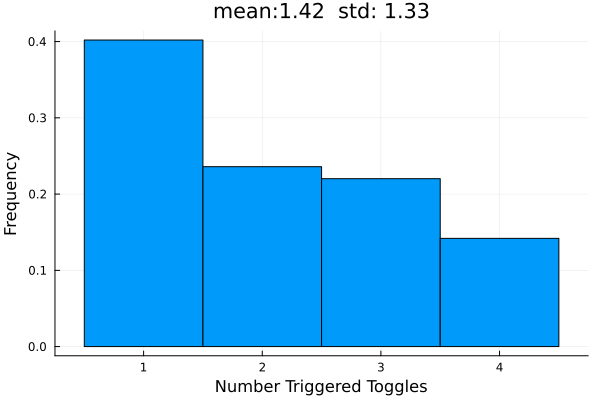

In [80]:
summed_seq = sum(hidden_data6, dims=1)
m = mean(summed_seq)
s = std(summed_seq)

b_range = range(0.5, 4.5, length=5)

histogram(Transpose(summed_seq), bins=b_range, normalize=:pdf, label=nothing)
xlabel!("Number Triggered Toggles")
ylabel!("Frequency")
title!("mean:$(round(m, digits=2))  std: $(round(s, digits=2))")

# Which toggle 

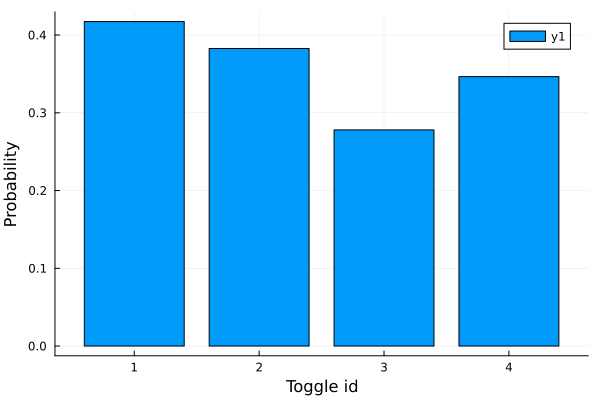

In [55]:
bar(1:4, mean(hidden_data6, dims=2))
xlabel!("Toggle id")
ylabel!("Probability")

## Covariance Matrix

In [61]:
toggle_cov

4×4 Matrix{Float64}:
 0.243213   0.0965077  0.0430173  0.022582
 0.0965077  0.236277   0.0847341  0.137696
 0.0430173  0.0847341  0.200739   0.0445497
 0.022582   0.137696   0.0445497  0.226484

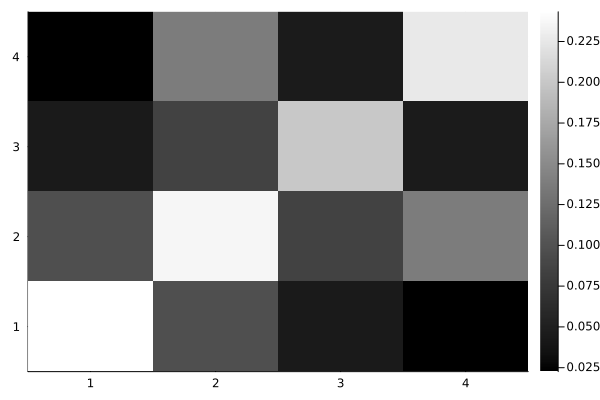

In [67]:
toggle_cov = cov(Transpose(hidden_data6))
heatmap(toggle_cov, color= :greys, transpose = false) #why y axis flipped?

# Statistics of the sequences

In [116]:
using StatsBase: countmap
data_joined = [join(Int.(hidden_data6[:,i]), "") for i in 1:size(hidden_data6)[2]]
counts = countmap(data_joined)


Dict{String, Int64} with 16 entries:
  "0011" => 44
  "0110" => 17
  "1100" => 295
  "1011" => 9
  "0001" => 328
  "1001" => 85
  "1110" => 343
  "1101" => 340
  "1010" => 32
  "0010" => 446
  "0101" => 504
  "1111" => 588
  "1000" => 859
  "0100" => 32
  "0000" => 1970
  "0111" => 220

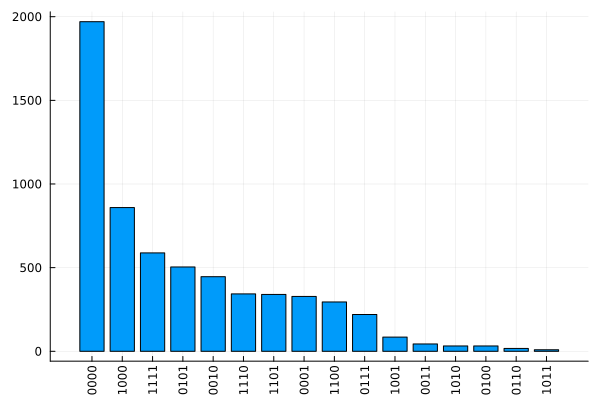

In [148]:
indipkey = collect(keys(counts))
vals  = collect(values(counts))
order = sortperm(vals, rev=true) 
indipkey = indipkey[order]
vals = vals[order]

bar(1:length(vals), vals, legend=false)
xticks!(1:length(vals), indipkey, xrotation =90)

# Sampling Conditioned to the toggle config

In [203]:
function toggle_to_seq_pca_space(toggle_conf)
    v6 = sample_v_from_h(rbm6, toggle_conf)
    h5 = v6
    v5 = sample_v_from_h(rbm5, h5)
    h4 = v5 
    v4 = sample_v_from_h(rbm4, h4)
    h3 = v4 
    v3 = sample_v_from_h(rbm3, h3)
    h2 = v3
    v2 = sample_v_from_h(rbm2, h2)
    h1 = v2
    seq = sample_v_from_h(rbm1, h1)
    flat_seq = reshape(seq, data_shape[1]*data_shape[2])
    #rotate and get pcas
    rot_flat_seq = transpose(O_v)*flat_seq
    return [rot_flat_seq[end-i, :] for i in 0:3]
end

toggle_to_seq_pca_space (generic function with 1 method)

In [227]:
Ndata = 100

data0000=zeros(4, Ndata)
data1000=zeros(4, Ndata)
data1111=zeros(4, Ndata)
data0101=zeros(4, Ndata)
data0010=zeros(4, Ndata)
for k in  1:Ndata
    data0000[:,k] = reduce(vcat, toggle_to_seq_pca_space([0,0,0,0]))
    data1000[:,k] = reduce(vcat, toggle_to_seq_pca_space([1,0,0,0]))
    data1111[:,k] = reduce(vcat, toggle_to_seq_pca_space([1,1,1,1]))
    #data0101[:,k] = reduce(vcat, toggle_to_seq_pca_space([0,1,0,1]))
    #data0010[:,k] = reduce(vcat, toggle_to_seq_pca_space([0,0,1,0]))

end

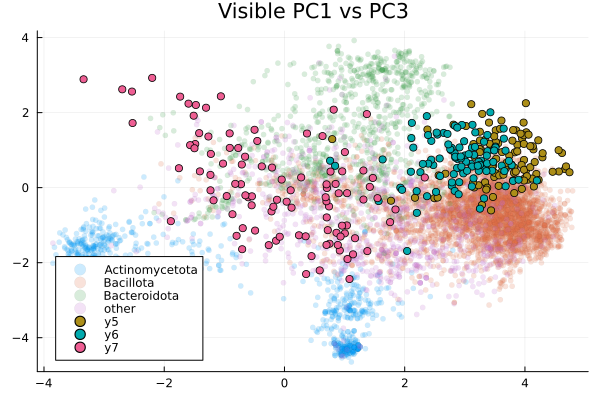

In [231]:
scatter(df_v.PC1 , markerstrokewidth=0.1, ms=3, markeralpha=0.2, df_v.PC3, group=df_v.Label, title="Visible PC1 vs PC3")

scatter!(data0000[1,:], data0000[2,:])
scatter!(data1000[1,:], data1000[2,:])
scatter!(data1111[1,:], data1111[2,:])
